# Conditional

Image is generated with a prompt and an image as condition such as depth map, posture, etc. as inputs to guide the output.

https://huggingface.co/docs/diffusers/en/using-diffusers/depth2img

In [2]:
import os, torch
import numpy as np
from PIL import Image
from diffusers.utils import load_image, make_image_grid
from diffusers import StableDiffusionDepth2ImgPipeline

os.environ["NCCL_P2P_DISABLE"] = "1"
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)

cuda


## depth to image

  0%|          | 0/35 [00:00<?, ?it/s]

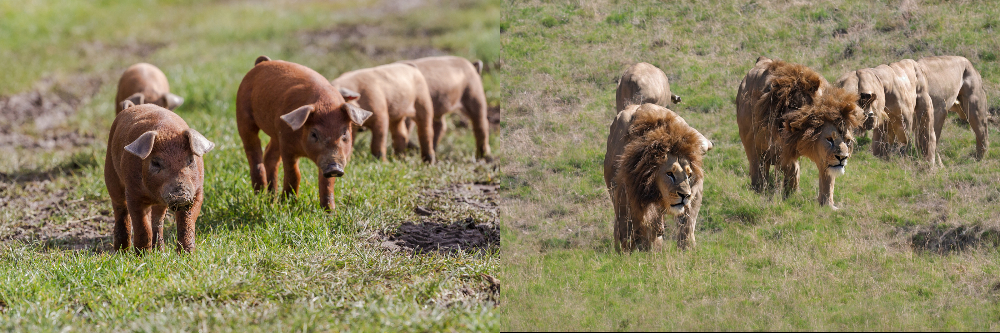

In [27]:

# pipe_depth = StableDiffusionDepth2ImgPipeline.from_pretrained("stabilityai/stable-diffusion-2-depth", 
#                                                             torch_dtype=torch.float16,
#                                                             use_safetensors=True
#                                                            ).to(device)


image = pipe_depth(prompt=prompt, image=input_image, negative_prompt=negative_prompt, strength=0.7).images[0]
make_image_grid([input_image, image], rows=1, cols=2)

In [89]:
import cv2, urllib.request


class DepthEstimator:
    """
    https://pytorch.org/hub/intelisl_midas_v2/
    """

    def __init__(self, _device):

        self.device = _device
        self.midas = torch.hub.load("intel-isl/MiDas", "DPT_Large")
        self.midas = self.midas.to(_device)
        transforms = torch.hub.load("intel-isl/MiDaS", "transforms")
        self.transform = transforms.dpt_transform

    def get_depth(self, image_path):

        # download image
        input_image = load_image(image_path)
        image = np.array(input_image.convert("RGB"))
        print("image size: ", image.shape)

        # get transformed image
        trans_image = self.transform(image).to(self.device)
        print("trans image size: ", trans_image.shape)

        with torch.no_grad():
            prediction = midas(trans_image)
            prediction = torch.nn.functional.interpolate(
                prediction.unsqueeze(1),
                size=img.shape[:2],
                mode="bicubic",
                align_corners=True,
            ).squeeze()

        output = prediction.cpu().numpy()
        print("depth size: ", output.shape)
        fig, ax = plt.subplots(1, 2, gridspec_kw = {'wspace':0, 'hspace':0})
        ax[0].imshow(image)
        ax[1].imshow(output)
        ax[0].axis("off")
        ax[1].axis("off")

        return input_image, output

depth_estimator = DepthEstimator(device)

Using cache found in /home/Qingyi/.cache/torch/hub/intel-isl_MiDas_master
Using cache found in /home/Qingyi/.cache/torch/hub/intel-isl_MiDaS_master


image size:  (1067, 1600, 3)
trans image size:  torch.Size([1, 3, 384, 576])
depth size:  (1213, 1546)


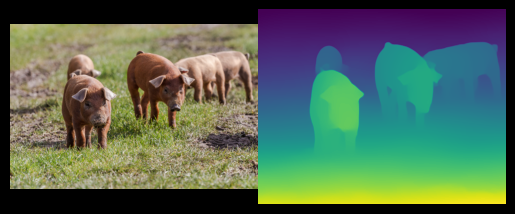

In [90]:
input_image, output = depth_estimator.get_depth(image_url)

  0%|          | 0/35 [00:00<?, ?it/s]

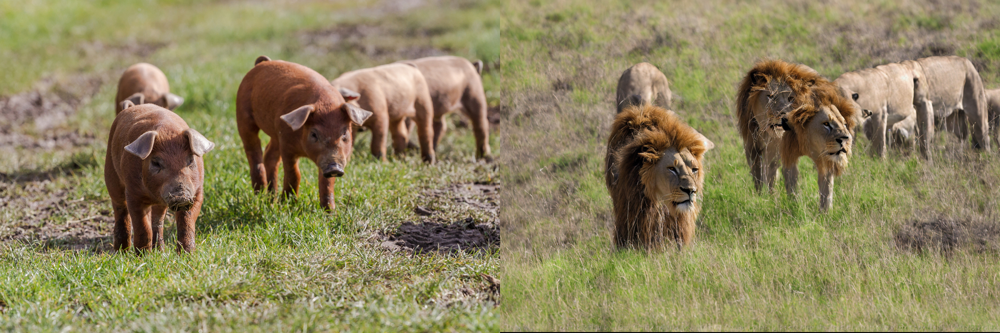

In [91]:
prompt = "a herd of lions"
negative_prompt = "bad quality, low quality, ugly, bad anatomy"

image = pipe_depth(prompt=prompt, image=input_image, negative_prompt=negative_prompt, strength=0.7).images[0]
make_image_grid([input_image, image], rows=1, cols=2)


image size:  (1213, 1546, 3)
trans image size:  torch.Size([1, 3, 384, 480])
depth size:  (1213, 1546)


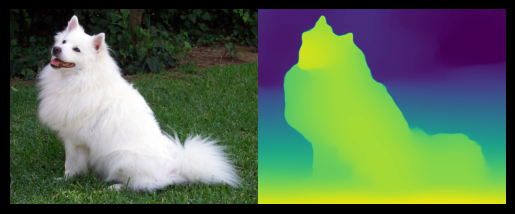

In [97]:
input_image, output = depth_estimator.get_depth("https://github.com/pytorch/hub/raw/master/images/dog.jpg")

  0%|          | 0/35 [00:00<?, ?it/s]

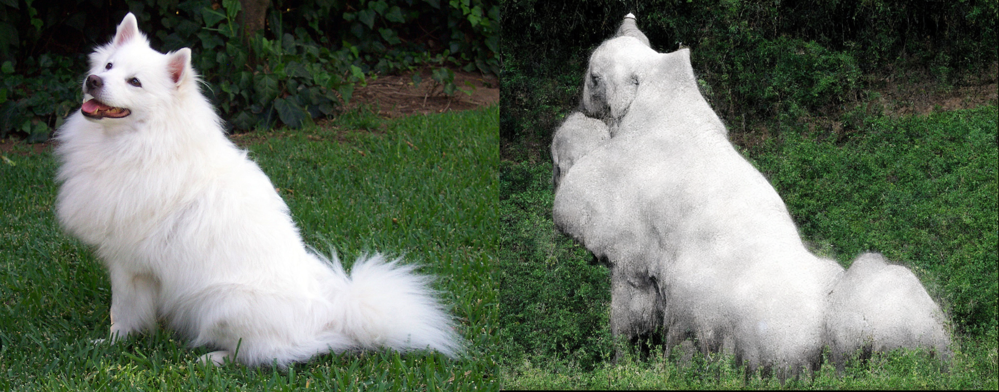

In [98]:
prompt = "an elephant"
negative_prompt = "bad quality, low quality, ugly, bad anatomy"

image = pipe_depth(prompt=prompt, image=input_image, negative_prompt=negative_prompt, strength=0.7).images[0]
make_image_grid([input_image, image], rows=1, cols=2)

image size:  (512, 512, 3)
trans image size:  torch.Size([1, 3, 384, 384])
depth size:  (1213, 1546)


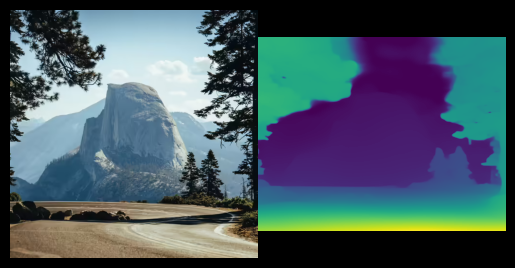

In [95]:
input_image, output = depth_estimator.get_depth("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint.png")

  0%|          | 0/35 [00:00<?, ?it/s]

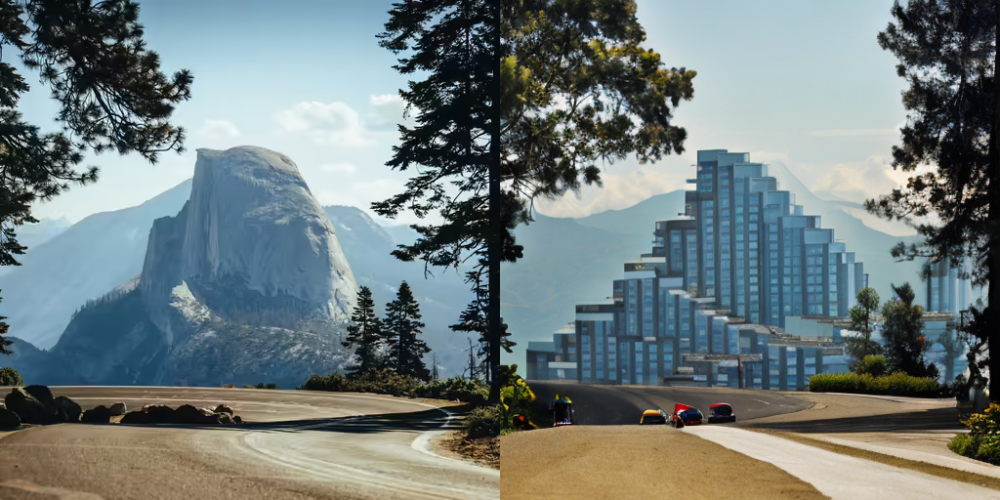

In [96]:
prompt = "a cat"
negative_prompt = "bad quality, low quality, ugly, bad anatomy"

image = pipe_depth(prompt=prompt, image=input_image, negative_prompt=negative_prompt, strength=0.7).images[0]
make_image_grid([input_image, image], rows=1, cols=2)

The use case works fine with one or several distinguishable objects, and the expected results are similar to the original images. However, for more complex scenes or objects, the results are bad. 

## posture to image

In [3]:
from controlnet_aux import OpenposeDetector

/home/Qingyi/.local/lib/python3.10/site-packages/controlnet_aux/mediapipe_face/mediapipe_face_common.py:7: UserWarning: The module 'mediapipe' is not installed. The package will have limited functionality. Please install it using the command: pip install 'mediapipe'
  warnings.warn(


In [5]:
# estimate posture from image

class PostureEstimator:

    # !pip install -q controlnet-aux

    def __init__(self, _device):

        from controlnet_aux import OpenposeDetector

        self.device = _device
        self.model = OpenposeDetector.from_pretrained("lllyasviel/ControlNet")

    def get_pose(self, file):

        input_image = load_image(file)
        posture = self.model(input_image)
        
        return input_image, posture


pos_estimator = PostureEstimator(device)

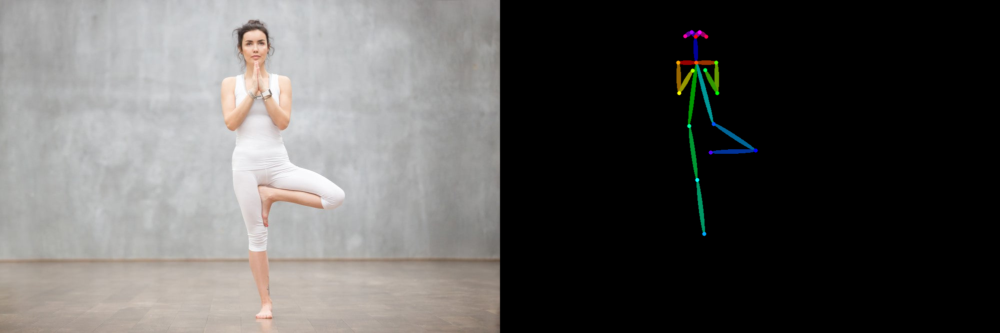

In [26]:
input_image, openpose_image = pos_estimator.get_pose("https://cdn.shopify.com/s/files/1/0030/3742/9849/files/8_Best_Yoga_Poses_for_Better_Posture8.jpg")
make_image_grid([input_image, openpose_image], rows=1, cols=2)

In [17]:
from diffusers import StableDiffusionXLControlNetPipeline, ControlNetModel

controlnet = ControlNetModel.from_pretrained("thibaud/controlnet-openpose-sdxl-1.0", torch_dtype=torch.float16)

pipe = StableDiffusionXLControlNetPipeline.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0", 
                                                            controlnet=controlnet, torch_dtype=torch.float16, 
                                                            use_safetensors=True).to(device)


/home/Qingyi/.local/lib/python3.10/site-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


diffusion_pytorch_model.bin:   0%|          | 0.00/5.00G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

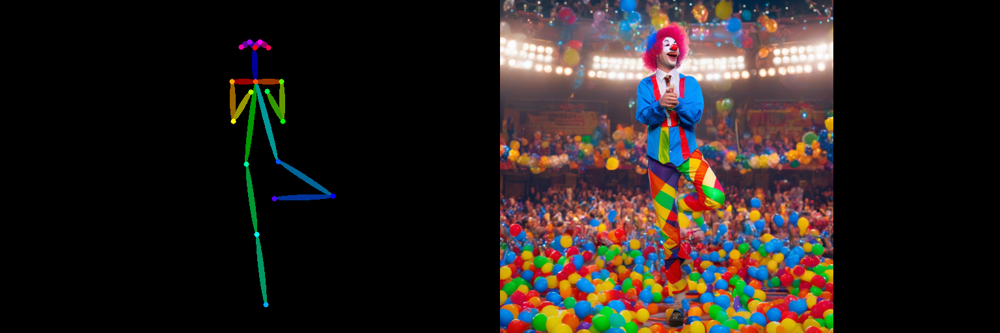

In [32]:
prompt = "a clown standing on a stage, best quality"
negative_prompt = "monochrome, lowres, bad anatomy, worst quality, low quality"

generator = torch.manual_seed(1)

images = openpose_image.resize((1024, 1024))

images = pipe(
    prompt,
    image=images,
    num_inference_steps=25,
    generator=generator,
    negative_prompt=negative_prompt,
    num_images_per_prompt=3,
    controlnet_conditioning_scale=1.0,
).images

make_image_grid([openpose_image, images[0].resize((512, 512))], rows=1, cols=2)


## canny edge

The controlnet and diffusion model should match:

 - for stable diffusion: StableDiffusionControlNetPipeline + "runwayml/stable-diffusion-v1-5" + "lllyasviel/sd-controlnet-canny"
 - for sdxl: StableDiffusionXLControlNetPipeline + "stabilityai/stable-diffusion-xl-base-1.0" + "diffusers/controlnet-canny-sdxl-1.0"

If getting errors for no reason, check if those models are compatible with each other.

image size:  (512, 512, 3)


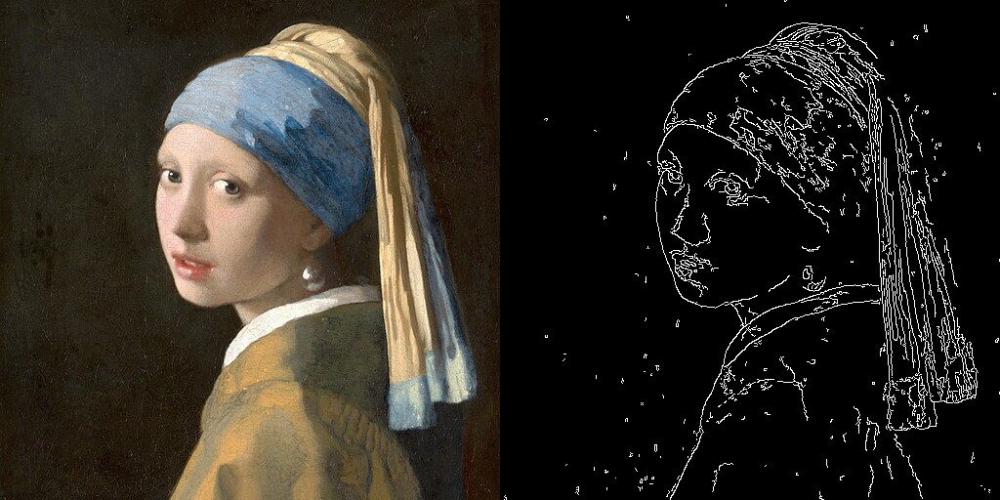

In [30]:
import cv2

def get_canny(file, rect=None):

    input_image = load_image(file)
    
    image = np.array(input_image.convert("RGB"))
    print("image size: ", image.shape)
    canny = cv2.Canny(image, 100, 200)[:,:,np.newaxis]

    canny = np.concatenate([canny, canny, canny], axis=-1)

    if rect is not None:
        print("remove")
        y, x, h, w = rect
        canny[x:x+w, y:y+h, :] = 0

    canny = Image.fromarray(canny.astype("uint8"))

    return input_image, canny


input_image, canny = get_canny("https://hf.co/datasets/huggingface/documentation-images/resolve/main/diffusers/input_image_vermeer.png")
make_image_grid([input_image, canny], rows=1, cols=2)

In [17]:
from diffusers import StableDiffusionXLControlNetPipeline, StableDiffusionControlNetPipeline, ControlNetModel
controlnet = ControlNetModel.from_pretrained("diffusers/controlnet-canny-sdxl-1.0", torch_dtype=torch.float16, use_safetensors=True)

pipe = StableDiffusionXLControlNetPipeline.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0", 
                                                            controlnet=controlnet, torch_dtype=torch.float16, 
                                                            use_safetensors=True).to(device)


/home/Qingyi/.local/lib/python3.10/site-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

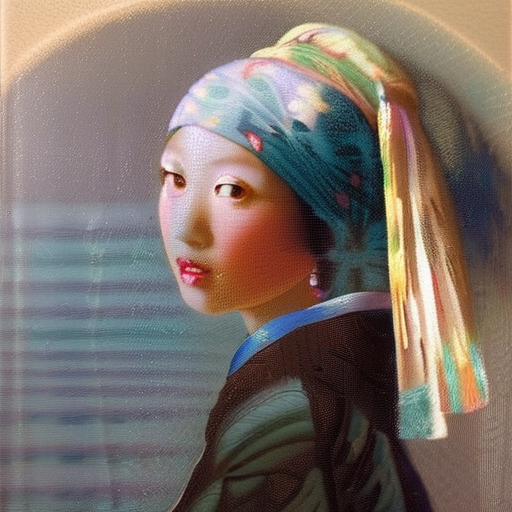

In [61]:
prompt = "a japanese woman"

negative_prompt = "monochrome, lowres, bad anatomy, worst quality"

output = pipe(prompt, negative_prompt=negative_prompt, image=canny).images[0]
output

  0%|          | 0/50 [00:00<?, ?it/s]

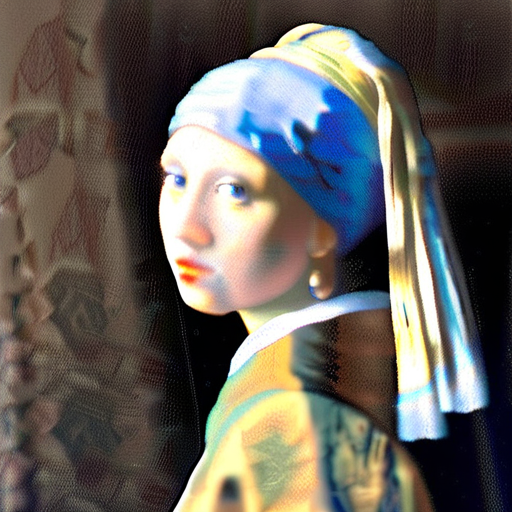

In [62]:
output = pipe("", image=canny, guess_mode=True).images[0]
output

image size:  (736, 736, 3)


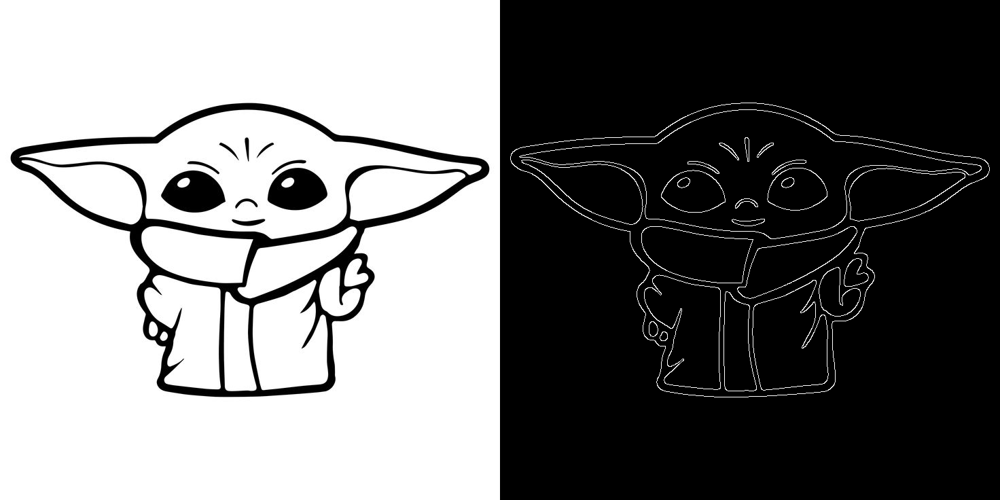

In [15]:
input_image, canny = get_canny("https://i.pinimg.com/736x/d4/96/d1/d496d1fa6abf50f57b119a8a370cc13f.jpg")
make_image_grid([input_image, canny], rows=1, cols=2)

  0%|          | 0/50 [00:00<?, ?it/s]

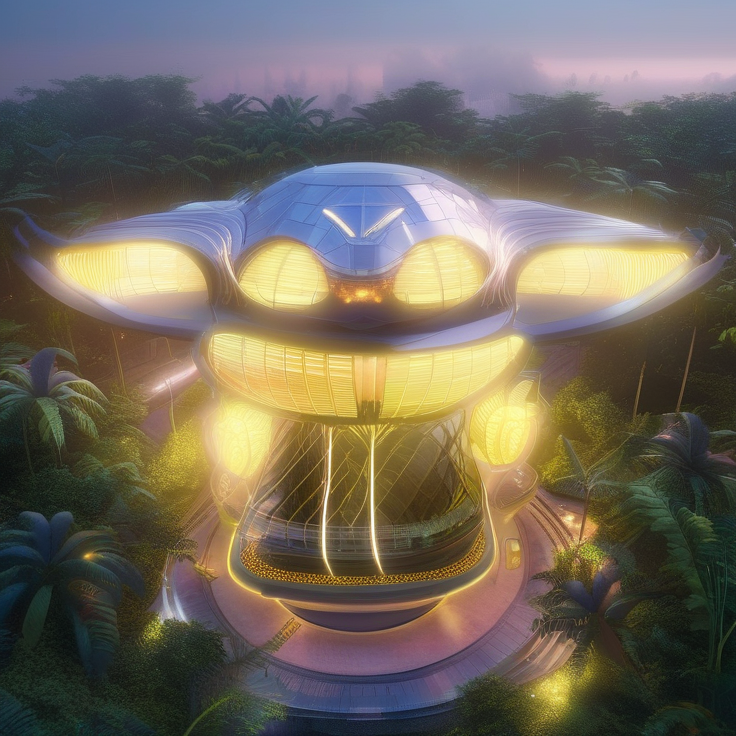

In [18]:
negative_prompt = "monochrome, lowres, bad anatomy, worst quality"
output = pipe("aerial view, a futuristic research complex in a bright foggy jungle, hard lighting", 
                negative_prompt=negative_prompt, image=canny, controlnet_conditioning_scale=0.5).images[0]
output

## Combine several inputs

image size:  (527, 800, 3)
remove


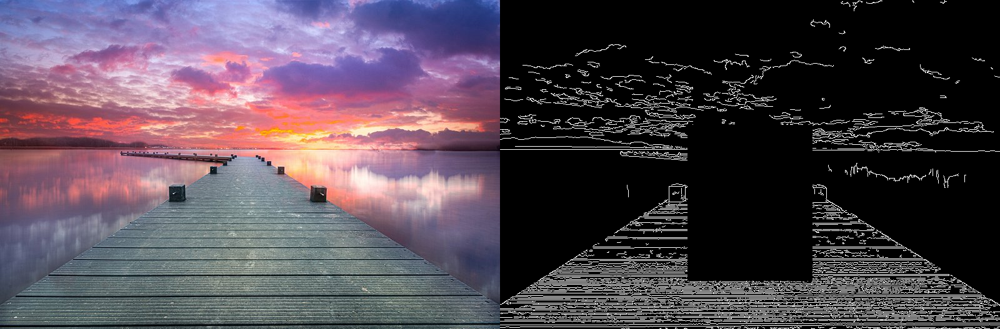

In [36]:
image_url = "https://images.rawpixel.com/image_800/cHJpdmF0ZS9sci9pbWFnZXMvd2Vic2l0ZS8yMDIyLTA1L3NrOTc5MS1pbWFnZS1rd3Z1amE5Ni5qcGc.jpg"
canny_image, canny = get_canny(image_url, rect=[300, 200, 200, 250])
make_image_grid([canny_image, canny], cols=2, rows=1)

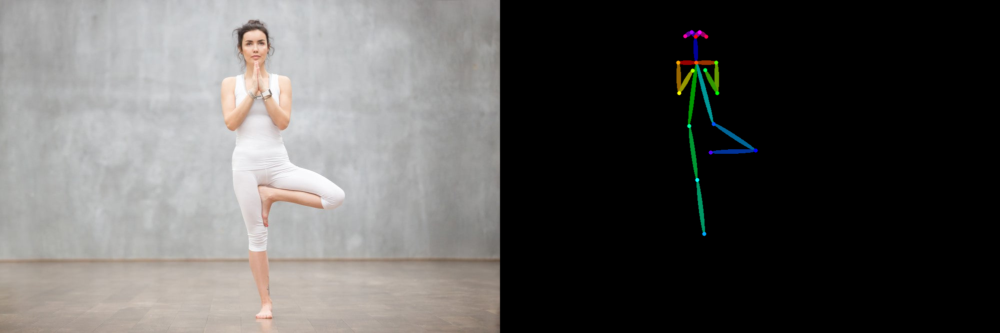

In [6]:
posture_image, openpose_image = pos_estimator.get_pose("https://cdn.shopify.com/s/files/1/0030/3742/9849/files/8_Best_Yoga_Poses_for_Better_Posture8.jpg")
make_image_grid([posture_image, openpose_image], rows=1, cols=2)

In [7]:
from diffusers import StableDiffusionXLControlNetPipeline, ControlNetModel

controlnets = [
    ControlNetModel.from_pretrained("thibaud/controlnet-openpose-sdxl-1.0", torch_dtype=torch.float16, use_safetensor=True),
    ControlNetModel.from_pretrained("diffusers/controlnet-canny-sdxl-1.0", torch_dtype=torch.float16, use_safetensor=True),
]

pipe = StableDiffusionXLControlNetPipeline.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0", controlnet=controlnets, torch_dtype=torch.half, use_safetensor=True).to(device)

/home/Qingyi/.local/lib/python3.10/site-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
Keyword arguments {'use_safetensor': True} are not expected by StableDiffusionXLControlNetPipeline and will be ignored.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

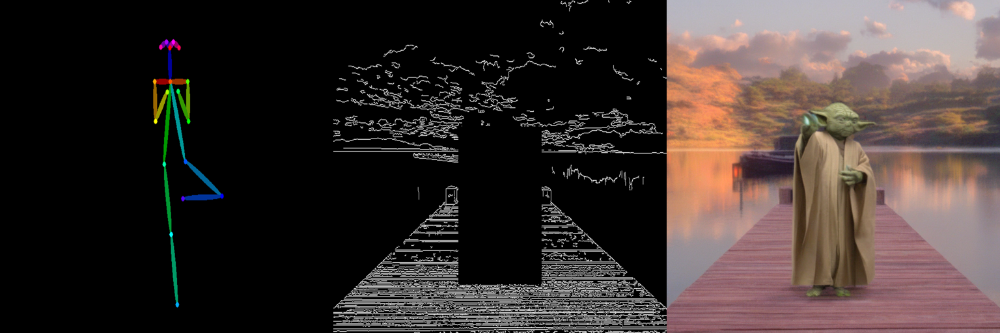

: 

In [46]:
prompt = "a yoda standing on the dock"
negative_prompt = "monochrome, lowres, bad anatomy, worst quality, low quality"

image_size = (1024, 1024)
images = [openpose_image.resize(image_size), canny.resize(image_size)]

output = pipe(prompt, negative_prompt=negative_prompt, image=images, controlnet_conditioning_scale=[1.0, 0.8]).images[0]
image_size = (512, 512)
make_image_grid([images[0].resize(image_size), images[1].resize(image_size), output.resize(image_size)], cols=3, rows=1)

In [1]:
!nvidia-smi

Wed Aug 14 17:24:48 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 555.58.02              Driver Version: 555.58.02      CUDA Version: 12.5     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 3090        Off |   00000000:08:00.0 Off |                  N/A |
| 52%   48C    P0            126W /  420W |       1MiB /  24576MiB |      3%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----